## Police Stop Data - Processing and exploration

The goal of this notebook is to create a dataframe with information relative to policing, demographics and public safety for the 90 neighborhoods of the city of Pittsburgh, Pennsylvania. 

The datasets with information on Pittsburgh :
- Police Stops: https://stacks.stanford.edu/file/druid:yg821jf8611/yg821jf8611_pa_pittsburgh_2020_04_01.csv.zip
- Demography: https://data.wprdc.org/dataset/pgh/resource/8ac5c768-09ba-43a8-829f-ce4a417d20fb?inner_span=True
- Public Safety: https://data.wprdc.org/dataset/pgh/resource/bd152875-a14d-421a-8656-cc896a7e9074
- Neighborhood Shapefile: https://data.wprdc.org/dataset/pgh/resource/b7156251-6036-4b68-ad2a-95566c84343e

The final product is a 90 lines dataframe, one for each neighborhood, with the following columns:

- Neighborhood Name
- Total Population
- General Population Demography: Percentages for White, Black, Asian, Hispanic, 2_races and other (6 columns)
- Subject Stopped Demography: Percentages for White, Black, Asian_pacific islander, Hispanic, unkown and other (6 columns)
- Part 1 Criminality: :  major crimes / 100 hab
- Part 2 Criminality:  minor crimes / 100 hab
- Number of stops
- Number of stops / population
- bias: there are more blacks stopped even though in a white residential area and vice-versa

Finding statistics by neighborhood implies averaging/counting points of the police dataset in each neighborhood.

### Scrip Summary
- Processing the police stop dataset
    - Clip to extent, add neighborhood to each stop, count number of stops in neighborhood
- Computing stopped subject race distribution by neighborhood
- Creating the neighborhood dataframe by merging the:
    - general demography race distribution 
    - the subject race distribution and stop count information
    - the criminality information

In [ ]:
#Importing Libraries
import pandas as pd
import geopandas as gpd #Spatial library, used to manipulate shapefiles
import numpy as np
import matplotlib.pyplot as plt

In [ ]:
#Importing data
df_police=pd.read_csv("data/pa_pittsburgh_2020_04_01.csv",low_memory=False)#Police stops in Pittsburgh (Stanford  database)
df_Pb_pop=pd.read_csv("data/population-density.csv")#Population information by neighborhood
df_Pb_safe=pd.read_csv("data/public-safety.csv")#Public safety information by neighborhood
gdf_neighborhoods=gpd.read_file("data/Neighborhoods_.shp")#Neighborhood shapefile

## Merging  the neighborhood shapefile with the general demography and criminality dataframes

In [ ]:
#Base dataframe: demography of Pittsburgh by neighborhood
df_hood=df_Pb_pop[["Neighborhood","Pop. 2010", "% African American (2010)","% Asian (2010)",
                   "% Other (2010)","% White (2010)","% 2+ Races (2010)","% Hispanic (of any race) (2010)"]]

#Transforming the Population from a string to a float
df_hood=df_hood.rename(columns={"Pop. 2010": "pop_2010",}) #Rename the colum
df_hood["pop_2010"]=df_hood["pop_2010"].str.replace(',','').astype(float) #Remove commas

#Transforming percentages to rates
column_names=["% African American (2010)","% Asian (2010)", "% Other (2010)","% White (2010)","% 2+ Races (2010)","% Hispanic (of any race) (2010)"]
for column in column_names:
    gdf_hood_new[column] = [float(x)/100 for x in gdf_hood_new[column].values]

#Adding the Criminality data
df_temp = df_Pb_safe[["Neighborhood","Part 1 Crime per 100 Persons (2010)","Part 2 Crime per 100 Persons (2010)"]]
df_hood=df_hood.merge(df_temp, left_on='Neighborhood', right_on='Neighborhood')

#Adding the shapefile data
gdf_neighborhoods=gdf_neighborhoods[["hood","geometry"]]
df_hood=df_hood.merge(gdf_neighborhoods, left_on='Neighborhood', right_on='hood')
df_hood=df_hood.drop(columns="hood")

#Changing name of columns
column_names=["Neighborhood","% African American (2010)","% Asian (2010)", "% Other (2010)","% White (2010)","% 2+ Races (2010)","% Hispanic (of any race) (2010)","Part 1 Crime per 100 Persons (2010)","Part 2 Crime per 100 Persons (2010)"]
new_names=["hood","black_demo","asian_demo", "other_demo","white_demo","2race_demo","hisp_demo","crime_1","crime_2"]
for column,new_name in zip(column_names,new_names):
    df_hood=df_hood.rename(columns={column:new_name})

In [ ]:
df_hood.head(3)

### Exporting the neighborhood dataframe to shapefile 

In [ ]:
gdf_hood=gpd.GeoDataFrame(df_hood)
gdf_hood.to_file(driver = 'ESRI Shapefile', filename="data/Pittsburgh_hood_first_step.shp")

#### Now that the neighborhood base shapefile is defined, we need to add the police stop informations. This means processing the data in this notebook, exporting is as a shapefile, and then processing it again in QGIS to add subject information on the neighborhood shapefile.

## Processing the police dataset

We only keep data on the location, date, subject related information, police officer related information and stop reason and outcome information. We remove the raw columns as well.

In [ ]:
df_police=df_police[["raw_row_number","date","time","lat","lng",
                             "subject_age","subject_race","subject_sex",
                             "officer_id_hash","officer_age","officer_race","officer_sex",
                             "type","violation","arrest_made","citation_issued","warning_issued","outcome",
                             "contraband_found","frisk_performed","search_conducted","reason_for_stop"]]


df_police=df_police.dropna(subset=['subject_race']) 

df_police.rename(columns={"raw_row_number":"stop_ID"})

df_police.head(2)

## Adding the neighborhood to each police stops

To easily manipulate spatial data, we use QGIS (https://www.qgis.org/en/site/), a "A Free and Open Source Geographic Information System", which highly simplifies the following tasks.

The first step is to create a shapefile of our police dataset:

In [ ]:
gdf_police = gpd.GeoDataFrame(df_police, geometry=gpd.points_from_xy(df_police.lng, df_police.lat))
gdf_police.to_file(driver = 'ESRI Shapefile', filename = "data/Pittsburgh_stops.shp") #Save to shapefile

After importing the police stops and the neighborhood shapefile in QGIS, we can start processing the data:

- Clipping to area of interest:

First of all, we are only interested by a specific area of Pittsburgh, that is the main 90 Pittsburgh neighborhoods:
https://en.wikipedia.org/wiki/List_of_Pittsburgh_neighborhoods. Therefore, we discard points which are not in this area. To do so, we use QGIS and its "Clip points in Polygon" (https://docs.qgis.org/2.8/en/docs/user_manual/processing_algs/gdalogr/ogr_geoprocessing/clipvectorsbypolygon.html) processing tool.

- Attributing to each stop location a neighborhood:

Then, we need to attribute to the police stops the name of the neighborhood the stop occured in. The Police Stop Dataset initially comes with information about the neighborhood, along with latitude and longitude of the stops. However, not all points have the neighborhood information, so we need to add it. To do so, we use the  "Join Attribute by Location" procesing tool in QGIS (https://docs.qgis.org/2.8/en/docs/user_manual/processing_algs/qgis/vector_general_tools/joinatributesbylocation.html).

- Counting the number of stop location by neighborhood:

Finally, we can count the number of stop by neighborhood using the "Count Points in polygon" processing tool (https://docs.qgis.org/2.8/en/docs/user_manual/processing_algs/qgis/vector_analysis_tools/countpointsinpolygon.html). We can also divide the number of stops by the population in each neighborhood, as to compensate for the fact that high population density neighborhoods have more stops. This is done with the "field calculator" processing tool (https://docs.qgis.org/2.8/en/docs/user_manual/working_with_vector/field_calculator.html)

### Importing the modified shapefiles

The stop shapefile has a new column: "hood" the neighborhood name for each stop

In [ ]:
gdf_police_new = gpd.read_file("data/Pittsburgh_stops_whood.shp")
gdf_police_new[["subject_ra","hood"]].head(3)

The neighborhood shapefile has 2 new columns: the number of stops and the number of stops normalized by population.

In [ ]:
gdf_hood_new = gpd.read_file("data/Pittsburgh_Neighborhood_data_v0.shp")
gdf_hood_new[["hood","stops_coun","stop_bypop"]].head(3)

## Adding statistics on subject race distribution

Now that we know in which neighborhood each stop is, we can compute the subject race distribution.

In [ ]:
data=gdf_police_new.groupby("hood")#group data by hood

races=gdf_police_new["subject_ra"].unique()#get all race names

#Initialize vectors for distribution information
white_dist=[]
black_dist=[]
hisp_dist=[]
other_dist=[]
as_pac_dist=[]
unknown_dist=[]

subj_race_dist=[]#Initialize vector for distribution information
subj_pop_by_hood=[]#Initialiaze  vector for population of subjects by hood

for hood in gdf_police_new["hood"].unique():
    temp=data.get_group(hood)
    
    white_count=len(temp[temp["subject_ra"]=="white"])
    black_count=len(temp[temp["subject_ra"]=="black"])
    hisp_count=len(temp[temp["subject_ra"]=="hispanic"])
    other_count=len(temp[temp["subject_ra"]=="other"])
    as_pac_count=len(temp[temp["subject_ra"]=="asian/pacific islander"])
    unknown_count=len(temp[temp["subject_ra"]=="unknown"])
    
    hood_subj_pop=len(temp["subject_ra"])
   
    white_dist.append(white_count/hood_subj_pop)
    black_dist.append(black_count/hood_subj_pop)
    hisp_dist.append(hisp_count/hood_subj_pop)
    other_dist.append(other_count/hood_subj_pop)
    as_pac_dist.append(as_pac_count/hood_subj_pop)
    unknown_dist.append(unknown_count/hood_subj_pop)

## Creating the final neighborhood dataframe

In [ ]:
#Adding the subject race distribution to the neighborhood geodataframe
gdf_hood_new["white_dist"]=white_dist
gdf_hood_new["black_dist"]=black_dist
gdf_hood_new["hisp_dist"]=hisp_dist
gdf_hood_new["other_dist"]=other_dist
gdf_hood_new["as_pac_dist"]=as_pac_dist
gdf_hood_new["unknown_dist"]=unknown_dist

gdf_hood_new.head(2)    

### Exporting as shapefile and as csv

In [ ]:
gdf_hood_new.to_csv("data/Pittsburgh_Neighborhood_data_V1.csv")
gdf_hood_new = gpd.GeoDataFrame(gdf_hood_new)
gdf_hood_new.to_file(driver = 'ESRI Shapefile', filename = "data/Pittsburgh_Neighborhood_data_V1.shp") #Save to shapefile

# Part 2: police officers
In this part we focus on the police officers: we will try to separate them into clusters and then analyse each cluster's stop behavior i.e. if they stop more blacks or whites.

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
sns.set_style('white')
sns.set_palette('Set1')

from sklearn.preprocessing import MinMaxScaler
import umap
import sklearn.cluster as cluster

import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
px.defaults.template = 'plotly_white'

import geopandas as gpd
from shapely import wkt

In [2]:
# define some constants that are used throughout the notebook

STOPS_DATA_PATH = '../data/Pittsburgh_stops_whood.zip'
NEIGH_DATA_PATH = '../data/Pittsburgh_Neighborhood_data_V1.csv'

RACES = ['black', 'white'] # races we're interested in
WHITE_COLOR = 'lightpink' # color used for plotting data associated to whites
BLACK_COLOR = 'black' # color used for plotting data associated to blacks
GENERATE_HTML = False # set to true if you want to generate html versions of plotly plots when running the notebook

---

## Load, clean and prepare data

In [3]:
stops = pd.read_csv(STOPS_DATA_PATH, compression='zip', low_memory=False)

In [4]:
# convert dates to correct format
stops.date = pd.to_datetime(stops.date)

# we drop all columns where we don't have enough information on the officer
stops.dropna(how='any', subset=['officer_age', 'officer_race', 'officer_sex'], inplace=True)

# we drop any columns that don't have enought information on the subject
stops.dropna(how='any', subset=['subject_race', 'subject_sex'], inplace=True)

# we drop all "raw" columns, as we don't need them
stops.drop(columns=list(stops.filter(regex = 'raw_')), inplace=True)

# we drop columns that have only nulls
stops.dropna(how='all', axis=1, inplace=True)

# we drop columns that have the same value everywhere (e.g. search_performed or type)
stops.drop(columns=[col for col in stops if len(stops[col].unique()) == 1], inplace=True)

# only keep black and white officers as they represent almost all of the data
stops = stops[stops.officer_race.isin(RACES)]

# convert race and sex to binary variables (white = 0, black = 1) (male = 0, female = 1)
stops.officer_race = (stops.officer_race == 'black') * 1
stops.officer_sex = (stops.officer_sex == 'female') * 1

In [5]:
stops.sample(3)

,date,time,lat,lng,subject_race,subject_sex,officer_id_hash,officer_age,officer_race,officer_sex,violation,arrest_made,citation_issued,warning_issued,outcome,contraband,frisk_performed,neighborhood
33189,2016-08-04,22:03:00,40.406424,-80.018475,white,female,769df4a7d8,48.0,0,0,Periods for Requiring Lighted Lamps.,0,0,1,warning,0.0,0.0,Brookline
134822,2016-04-08,08:30:00,40.425534,-80.020036,white,male,054e9e92fd,41.0,0,0,Maximum Speed Limits.,0,1,0,citation,0.0,0.0,Mount Washington
199276,2017-07-30,21:09:00,40.441757,-79.941561,white,male,6f665a5062,31.0,0,0,Stop Signs and Yield Signs.,0,1,0,citation,0.0,0.0,Squirrel Hill North


---

## Clustering officers
We tested multiple approaches, they are all explained in this section.

### Extract officer data and create a "profile" for each officer
We have pretty limited data on the officers available to us:
- race
- sex
- age at the time of the stop

We decided to take the mean age of each officer across their stops, and capture their "experience" by taking the number of days between their first and last intervention, as well as the amount of stops they performed. We keep only officers that are black or white, as together they represent ~99% of the data. That way it can be transformed to a binary variable. This gives us the following "profile" for each officer:
- race: categorical value, either 0 (white) or 1 (black)
- sex: categorical value, either 0 (male) or 1 (female)
- age_mean: mean age computed over all their stops
- days_interval: number of days worked, computed between the first recorded stop and the last one (we add 1 so that officers who worked only 1 day have a value of 1)
- n_stops: the total number of stops performed

In [6]:
num_days = lambda x: pd.to_timedelta(np.nanmax(x) - np.nanmin(x)).days + 1

# aggregate data for each officer, and compute some other features
officer_data = stops.groupby('officer_id_hash').agg(
                                                    age_mean=('officer_age', np.nanmean),
                                                    race=('officer_race', np.nanmean),
                                                    sex=('officer_sex', np.nanmean),
                                                    days_interval=('date', num_days),
                                                    n_stops=('officer_id_hash', 'count')    
                                                )

# to get the subject race or other info we can do a join with the original data on the officer_id_hash

In [7]:
officer_data.sample(3)

,age_mean,race,sex,days_interval,n_stops
officer_id_hash,,,,,
a90dacf19f,28.000000,0,0,1,1
5f71fab41a,62.652632,0,0,2139,95
b3170b66de,57.231169,1,0,2252,385


In [8]:
# plot distribution of officers

# pie chart for categorical features
# we use distinct colors for male and female (use pink for males because pink isn't just for girls)
# we also use darker versions of the same colors for black officers
temp = officer_data.copy()
categories = ['White males', 'Black males', 'White females', 'Black females']
temp['group'] = temp.apply(lambda x: categories[int(x.race + 2*x.sex)], axis=1)
fig = px.pie(temp, names='group',
             color_discrete_sequence=['violet', 'gold', 'purple', 'darkgoldenrod'])
fig.update_layout(title='Officer race and sex distribution', title_x=0.5, font_family='Rockwell', hovermode=False, height=400)
fig.update_traces(textposition='inside' ,textfont_size=16)
if GENERATE_HTML: fig.write_html('../plots/officer-data-distribution-pie.html', full_html=False, include_plotlyjs=False)
else: fig.show()
    
# histograms for numerical features
fig = make_subplots(rows=1, cols=3, y_title='% of officers')
fig.add_trace(go.Histogram(x=officer_data.age_mean, name='Officer age', histnorm='percent'), row=1, col=1)
fig.add_trace(go.Histogram(x=officer_data.days_interval, name='Days of service', histnorm='percent'), row=1, col=2)
fig.add_trace(go.Histogram(x=officer_data.n_stops, name='Number of stops', histnorm='percent'), row=1, col=3)
fig.update_layout(template='plotly_white', title='Officer distribution', title_x=0.5, font_family='Rockwell', hovermode=False, height=400, width=1000)
fig.update_yaxes(type='log', row=1, col=3)
if GENERATE_HTML: fig.write_html('../plots/officer-data-distribution.html', full_html=False, include_plotlyjs=False)
else: fig.show()

In [9]:
# Utility functions:

def plotUMAP(data, neighbors = 30):
    scaled = MinMaxScaler().fit_transform(X=data)
    u = umap.UMAP(n_components=2, n_neighbors=neighbors, min_dist=0, random_state=42).fit_transform(scaled)
    plt.scatter(u[:,0], u[:,1], s=10)
    plt.show()
    return u

def plotDBSCAN(u):
    _, labels = cluster.dbscan(u, eps=0.8)
    mask = labels >= 0
    plt.scatter(u[mask,0], u[mask,1], c=labels[mask], s=10, cmap='Spectral', alpha=0.5)
    plt.scatter(u[~mask,0], u[~mask,1], c='red', s=50, marker='x') # display those that weren't clustered
    plt.show()
    return labels
    
def plotPLOTLY(clustered):
    # plot with plotly
    string = lambda x: f"{'White' if x.race == 0 else 'Black'} {'male' if x.sex == 0 else 'female'}"
    fig = px.scatter(clustered, x='x', y='y', color='cluster', hover_name=clustered.apply(string,axis=1),
                     hover_data={
                         'x': False,
                         'y': False,
                         'cluster': False,
                         'age': (':.0f', clustered.age_mean),
                         'days worked': clustered.days_interval,
                         'number of stops': clustered.n_stops
                     })
    fig.update_layout(
        title_text='Police officers, clustered by their features',
        title_x=0.5,
        width=600,
        height=400,
        font_family="Rockwell",
        hoverlabel=dict(
            bgcolor="white",
            font_size=16,
            font_family="Rockwell",
        )
    )
    fig.update_yaxes(visible=False)
    fig.update_xaxes(visible=False)
    fig.show()
    if GENERATE_HTML: fig.write_html(file='../plots/clusters-scatter-general.html', full_html=False, include_plotlyjs=False)
        
def plot_feature(clustered, feature, title, yaxislabel, logy=False):
    fig = px.box(clustered, y=feature, x='cluster', color='cluster', log_y=logy)
    fig.update_layout(
        title_text=title,
        title_x=0.5,
        width=600,
        height=400,
        font_family="Rockwell",
        hoverlabel=dict(
            bgcolor="white",
            font_size=16,
            font_family="Rockwell",
        )
    )
    fig.update_yaxes(title=yaxislabel)
    fig.update_xaxes(visible=False)
    return fig

In [10]:
# Lamdba used to group by data

num_days = lambda x: pd.to_timedelta(np.max(x) - np.min(x)).days + 1
ratio = lambda x: 0 if len(x) == 0 else (np.sum(x))/ len(x)

### First clustering technique: Using subset of columns

In [11]:
# aggregate data for each officer, and compute some other features
officer_data_c1 = stops.groupby('officer_id_hash').agg(
                                                    age_mean=('officer_age', np.nanmean),
                                                    race=('officer_race', np.nanmean),
                                                    sex=('officer_sex', np.nanmean),
                                                    days_interval=('date', num_days),
                                                    n_stops=('officer_id_hash', 'count')
                                                )

In [12]:
officer_data_c1.sample(3)

,age_mean,race,sex,days_interval,n_stops
officer_id_hash,,,,,
d2b2c4ad59,45.000000,0,0,2,2
f88ac319d3,26.000000,0,0,1,1
0c9cf90569,41.438596,0,1,1395,114


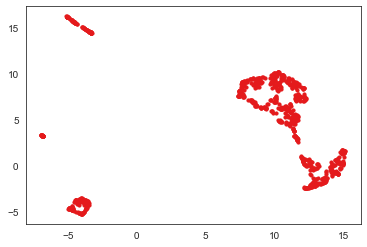

In [13]:
umap_c1 = plotUMAP(officer_data_c1)

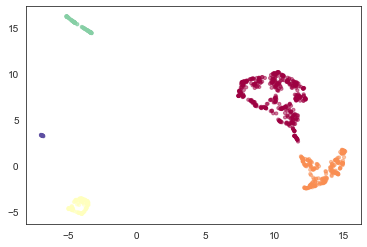

In [14]:
labels_c1 = plotDBSCAN(umap_c1)

In [15]:
clustered_c1 = pd.DataFrame({'x': umap_c1[:,0], 'y': umap_c1[:,1], 'cluster': map(repr,labels_c1)})
clustered_c1 = pd.concat([officer_data_c1.reset_index(), clustered_c1], axis=1)
plotPLOTLY(clustered_c1)

It seems that our data is separated using the color of the police officier and it's sex.
We also note that the cluster of "White Male" is splitted in two, depending on the number of days worked and the number of stops.

One striking observation is the size difference of the clusters: we see that our algorithm did not split the "White Male" cluster enough to have clusters of similar sizes.

Let's have a look at the different features distributions:

In [16]:
fig1 = plot_feature(clustered_c1, 'age_mean', 'Distribution of officer age among clusters', 'age')
fig1.show()

In [17]:
fig2 = plot_feature(clustered_c1,'days_interval', 'Distribution of days of service among clusters', 'number of days')
fig2.show()

In [18]:
fig3 = plot_feature(clustered_c1, 'n_stops', 'Distribution of the number of stops among clusters', 'number of stops (log-scale)', True)
fig3.show()

We see that UMAP-DBSCAN clustered our data in 5 clusters:
- Young/Low experience white male (0)
- Old/ Experienced white male     (1)
- White female                    (2)
- Black male                      (3)
- Black female                    (4)

However, this does not solve our problem: clustres 0 and 1 are way bigger than the other. Hence, we try to add variables to make further splits.

### Second clustering technique: Using all columns

In [19]:
# aggregate data for each officer, and compute some other features
officer_data_c2 = stops.groupby('officer_id_hash').agg(
                                                    age_mean=('officer_age', np.nanmean),
                                                    race=('officer_race', np.nanmean),
                                                    sex=('officer_sex', np.nanmean),
                                                    days_interval=('date', num_days),
                                                    n_stops=('officer_id_hash', 'count'),
                                                    citation=('citation_issued', ratio),
                                                    warning=('warning_issued', ratio),
                                                    contraband=('contraband', ratio),
                                                    frisk=('frisk_performed', ratio)
                                                )

In [20]:
officer_data_c2.sample(3)

,age_mean,race,sex,days_interval,n_stops,citation,warning,contraband,frisk
officer_id_hash,,,,,,,,,
55db40558a,38.000000,0,0,132,2,0.000000,0.00000,0.0,0.500000
b3768cafc2,51.800000,0,0,847,20,0.350000,0.50000,0.0,0.000000
bb77f90379,41.203883,0,1,2269,103,0.203883,0.76699,0.0,0.058252


Now that our data is ready to be clustered, we use UMAP to create a 2d representation of our clusters

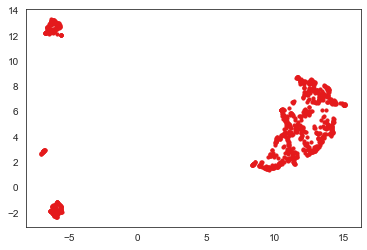

In [21]:
umap_c2 = plotUMAP(officer_data_c2)

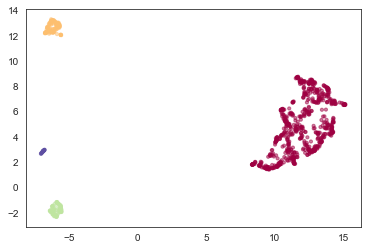

In [22]:
labels_c2 = plotDBSCAN(umap_c2)

In [23]:
clustered_c2 = pd.DataFrame({'x': umap_c2[:,0], 'y': umap_c2[:,1], 'cluster': map(repr,labels_c2)})
clustered_c2 = pd.concat([officer_data_c2.reset_index(), clustered_c2], axis=1)
plotPLOTLY(clustered_c2)

We see that our data is clustered in the same manner as the first technique: the split is even worse! We have now the white male cluster that is even bigger.

While looking at the arrest distribution, we notive something interesting:

In [24]:
fig3 = plot_feature(clustered_c2, 'n_stops', 'Distribution of the number of stops among clusters', 'number of stops (log-scale)', True)
fig3.show()

We notice that some officers have a huge amount of arrest (the median is at 123 arrests, and some officers have 5365 or 6565 arrets)!

We believe that those officers have a huge imact on the clustering. Hence, we want to try to remove them to see if they have a real influence.

### Third clustering technique: Excluding outliers

In [25]:
officer_data_c3 = stops.groupby('officer_id_hash').agg(
                                                    age_mean=('officer_age', np.nanmean),
                                                    race=('officer_race', np.nanmean),
                                                    sex=('officer_sex', np.nanmean),
                                                    days_interval=('date', num_days),
                                                    n_stops=('officer_id_hash', 'count')
                                                )

In [26]:
from scipy import stats
zscore = stats.zscore(officer_data_c3['n_stops'])
officer_data_no_outliers = officer_data_c3[np.abs(zscore < 3)]
officer_data_outliers = officer_data_c3[np.abs(zscore > 3)]

#### Clusters without outliers

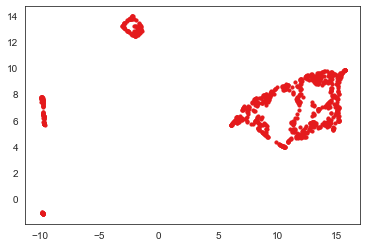

In [27]:
umap_c3_no = plotUMAP(officer_data_no_outliers)

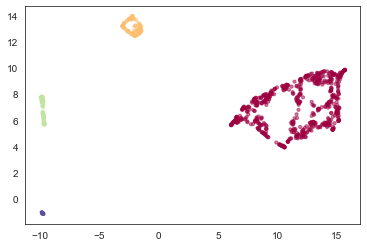

In [28]:
labels_c3_no = plotDBSCAN(umap_c3_no)

In [29]:
clustered_c3_no = pd.DataFrame({'x': umap_c3_no[:,0], 'y': umap_c3_no[:,1], 'cluster': map(repr,labels_c3_no)})
clustered_c3_no = pd.concat([officer_data_no_outliers.reset_index(), clustered_c3_no], axis=1)
plotPLOTLY(clustered_c3_no)

We clearly see that the unbalanced cluster size is still present. Hence this technique is not necessarily better...

But are the outliers similar?

#### Outliers cluster

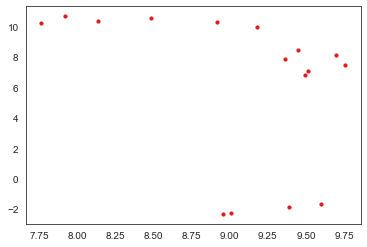

In [30]:
umap_c3_o = plotUMAP(officer_data_outliers, 3)

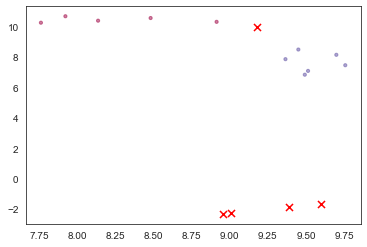

In [31]:
labels_c3_o = plotDBSCAN(umap_c3_o)

In [32]:
clustered_c3_o = pd.DataFrame({'x': umap_c3_o[:,0], 'y': umap_c3_o[:,1], 'cluster': map(repr,labels_c3_o)})
clustered_c3_o = pd.concat([officer_data_outliers.reset_index(), clustered_c3_o], axis=1)
plotPLOTLY(clustered_c3_o)

In [33]:
fig4 = plot_feature(clustered_c3_o, 'n_stops', 'Distribution of officer\'s number of stops among clusters', 'Number of arrests')
fig4.show()

We clearly see that the majority of the outliers points cannot be clustered together). It implies that they are very different.

Note that we see that the officers that have the most arrests are clustered together, implying that when once one reach a certain number of arrest you will be part of this cluster.

### Final clustering technique: manual clustering
After failing to produce satisfying clusters using other methods and having learned a lot about our data after handling it so much, we attempt manual clustering. \
First, we decide to keep only white male officers as they represent a huge part of the officers and also it removes the 2 variables that were always determining how the clusters were split: race and sex. \
We cut our white males' data into 3 groups for `age_mean` and 3 groups for `days_interval`. We split at the 0.33 quantile and the 0.66 quantile to get more or less balanced out clusters.

In [34]:
# keep only white males
white_males = officer_data.query('race == 0 & sex == 0')

In [35]:
G = 3 # number of groups for each variable
clustered = white_males.copy().reset_index()

# we use qcut to separate the data into `G` groups, we do so for both features
# we also store the buckets as nicely formatted strings (e.g. [22 - 34] for age), useful for plotting later on
labels, buckets = pd.qcut(clustered.age_mean, G, retbins=True, labels=False)
age_buckets = []
for i in range(1,len(buckets)):
    age_buckets.append(f'{buckets[i-1]:.0f} - {buckets[i]:.0f}')
age_labels = labels.values

labels, buckets = pd.qcut(clustered.days_interval, G, retbins=True, labels=False)
days_buckets = []
for i in range(1,len(buckets)):
    days_buckets.append(f'{buckets[i-1]/365:.0f} - {buckets[i]/365:.0f}') # here we divide the number of days by 365 to get ~ the number of years
days_labels = labels.values

# each category (age group, days worked group) is mapped to a unique value -> assigned cluster
clustered['cluster'] = age_labels + G * days_labels

#### Analyze / identify clusters
We plot the resulting clusters with box plots of the features

In [36]:
def plot_feature(feature, title, yaxislabel, logy=False):
    fig = px.box(clustered, y=feature, x='cluster', color='cluster', log_y=logy, category_orders={'cluster':sorted(clustered.cluster)})
    fig.update_layout(
        title_text=title,
        title_x=0.5,
        height=400,
        font_family="Rockwell",
        hoverlabel=dict(
            bgcolor="white",
            font_size=16,
            font_family="Rockwell",
        )
    )
    fig.update_yaxes(title=yaxislabel)
    fig.update_xaxes(visible=False)
    return fig

In [37]:
fig1 = plot_feature('age_mean', 'Distribution of officer age among clusters', 'age')
if GENERATE_HTML: fig1.write_html(file='../plots/clusters-box-age.html', full_html=False, include_plotlyjs=False)
else: fig1.show()

In [38]:
fig2 = plot_feature('days_interval', 'Distribution of days of service among clusters', 'number of days')
if GENERATE_HTML: fig2.write_html(file='../plots/clusters-box-days.html', full_html=False, include_plotlyjs=False)
else: fig2.show()

---

## Distribution of subjects race for each cluster
Once we have the clusters, we can merge with the original dataset of stops to compute the distribution of stops for each cluster. We can then compare the distributions for all clusters and see if a pattern emerges. \
We proceed as follows: take all the stops a cluster performed and count the number of stops there is for each (subject) race. Then, since the distribution of stops isn't uniform (overall whites represent a larger portion of those who are stopped, as there are a lot more white people in Pittsburgh) we adjust our values by dividing by the fraction this race represents (for example if blacks represent 0.2 of total stops and whites 0.5, and we have 10 stops of both blacks and whites, the adjusted values will be $\frac{10}{0.2} = 50$ for blacks and $\frac{10}{0.5} = 20$ for whites. Finally, we normalize across each cluster so that for each cluster we have the percentage of total stops each race represents. \
When plotting, we only compare subjects that are black or white as they represent a huge portion of our data (other races such as asians or hispanics don't have enough data for us to show anything meaningful).

In [39]:
# merge clustered data and full dataset with stops
merged = clustered[['officer_id_hash', 'cluster']].merge(stops, left_on='officer_id_hash', right_on='officer_id_hash')

In [40]:
# add a norm column, representing fraction of subjects that are of that race
norms = dict(stops.subject_race.value_counts(normalize=True))
merged['norm'] = merged.apply(lambda row: norms[row.subject_race], axis=1)
norms

{'white': 0.5721879865565527,
 'black': 0.36946301792291686,
 'other': 0.021873315160157412,
 'asian/pacific islander': 0.015685701472833453,
 'unknown': 0.013030267911579605,
 'hispanic': 0.007759710975960012}

In [41]:
# group data by the cluster and subject race
# adjust the count by dividing by the corresponding value in `norms`
# also compute a normalized version for each cluster, so we can easily compare with same y-axis
grouped = merged.groupby(['cluster','subject_race'], as_index=False).agg(count=('subject_race', 'size'),
                                                                     adjusted=('norm', lambda x: len(x)/np.mean(x)))
grouped['normalized'] = grouped.groupby('cluster')['adjusted'].transform(lambda x: x/x.sum())
grouped.head(6)

,cluster,subject_race,count,adjusted,normalized
0,0,asian/pacific islander,126,8032.793447,0.184606
1,0,black,3454,9348.702935,0.214848
2,0,hispanic,65,8376.600649,0.192507
3,0,other,157,7177.695692,0.164955
4,0,unknown,77,5909.318252,0.135805
5,0,white,2671,4668.046276,0.107279


In [42]:
# keep only black and white subjects
bw = grouped[grouped.subject_race.isin(RACES)]

In [43]:
# DEPRECATED: plot bars for both black and white for each cluster
# fig = px.bar(bw, x='subject_race', y='normalized', 
#              facet_col='cluster', color='subject_race', color_discrete_sequence=[BLACK_COLOR, WHITE_COLOR])
# fig.update_layout(
#     #hovermode=False,
#     title_text='Stop distribution by cluster',
#     title_x=0.5,
#     font_family="Rockwell",
#     hoverlabel=dict(
#         bgcolor="white",
#         font_size=16,
#         font_family="Rockwell",
#     )
# )
# fig.for_each_annotation(lambda a: a.update(text=a.text.split("=")[-1], y=-0.1))
# fig.layout.xaxis.fixedrange = True
# fig.layout.yaxis.fixedrange = True
# fig.update_layout(
# annotations = list(fig.layout.annotations) + 
#     [go.layout.Annotation(
#             y=-0.15,
#             x=0.5,
#             font=dict(
#                 size=14
#             ),
#             showarrow=False,
#             text="cluster",
#             xref="paper",
#             yref="paper"
#         )
#     ]
# )
# fig.update_yaxes(title='', tickformat='.2%')
# for axis in fig.layout:
#     if type(fig.layout[axis]) == go.layout.XAxis:
#         fig.layout[axis].title.text = ''
# fig.show()

In [44]:
# get delta between black and white, so we can plot a single bar 
# we compute a "black bias" variable which is the difference between the percentages black and white subjects represent of a given cluster's stops
bw_single_val = bw.groupby('cluster').agg(delta = ('normalized', lambda x: list(x)[0]-list(x)[1])).reset_index()
bw_single_val['subject race'] = bw_single_val.apply(lambda x: 'black' if x.delta > 0 else 'white', axis=1)

In [45]:
# plot the "black bias" on a bar chart, one bar per cluster
fig = px.bar(bw_single_val, x='cluster', y='delta', color='subject race', category_orders={'cluster': sorted(bw_single_val.cluster.values), 'subject race': ['white', 'black']},
            hover_data={
                'cluster':False,
                'subject race':False,
                'delta': ':.2%'
            },
            color_discrete_sequence=[WHITE_COLOR, BLACK_COLOR],
            labels={'delta':'Black bias', 'subject race': 'Subject race'})
fig.update_layout(
    title_text='Difference between % of blacks stopped and % of whites stopped',
    title_x=0.5,
    font_family="Rockwell",
    hoverlabel=dict(
        bgcolor="white",
        font_size=16,
        font_family="Rockwell",
    )
)
fig.layout.xaxis.fixedrange = True
fig.layout.yaxis.fixedrange = True
fig.update_yaxes(title='Black bias', tickformat= '.2%')
if GENERATE_HTML: fig.write_html(file='../plots/clusters-bar-bw.html', full_html=False, include_plotlyjs=False)
else: fig.show()

In [46]:
# as we have a lot of clusters, it isn't straightforward to read the bar chart
# therefore we also show it using a heat map
# we need to pivot the data into a matrix as plotly requires such format
# we organise the clusters such that we have age on the x axis and days (here we show it in years) of experience
# the clusters are also organised in a "logical way" so that we have a grid like this:
# | 0 | 1 | 2 |
# | 3 | 4 | 5 |
# | 6 | 7 | 8 |
bw_single_val['Years of service'] = bw_single_val.cluster % G
bw_single_val['Age category'] = bw_single_val.cluster // G
temp = bw_single_val.pivot(index='Age category', columns='Years of service', values=['delta', 'cluster'])
temp

delta                     cluster          
Years of service         0         1         2       0    1    2
Age category                                                    
0                 0.107569  0.114183 -0.039107     0.0  1.0  2.0
1                 0.128294  0.092911 -0.049499     3.0  4.0  5.0
2                 0.147043  0.006776 -0.062913     6.0  7.0  8.0

In [47]:
fig = px.imshow(temp.delta, color_continuous_scale=[WHITE_COLOR,'white',BLACK_COLOR], color_continuous_midpoint=0,
               labels=dict(color='Black bias'))
fig.update_layout(title='Racial bias in stops vs officer profile (white males)', title_x=0.5, font_family='Rockwell', hoverlabel=dict(
        bgcolor="white",
        font_size=16,
        font_family="Rockwell",
    ))
fig.update_xaxes(title='Officer age category',tickvals=[i for i in range(G)],ticktext=['Young', 'Middle-aged', 'Old']) #age_buckets)
fig.update_yaxes(title='Years of service', tickvals=[i for i in range(G)],ticktext=days_buckets)
fig.update_traces(customdata=temp.cluster,hovertemplate='<b>Cluster %{customdata}</b><br><br>Age category: %{x}<br>Years of service: %{y}<br>Black bias: %{z:.2%}<extra></extra>')
fig.update_layout(coloraxis_colorbar=dict(tickformat='%',thickness=10,x=0.9))
if GENERATE_HTML: fig.write_html(file='../plots/clusters-heatmap-bw.html', full_html=False, include_plotlyjs=False)
else: fig.show()

We redo the whole process to regenerate clusters and the heatmap for black officers as well, so that we can compare it with the heatmap for white male officers. The only change necessary in the code is when we create the variable `white_officers`. To select all black officers we simply do `officer_data.query('race == 1')`.

---

## Neighborhood plots
We use the previously generated / complied data about neighborhoods to plot some maps.

In [48]:
neighs = pd.read_csv(NEIGH_DATA_PATH)

In [49]:
neighs.head(2)

,Unnamed: 0,hood,pop_2010,black_demo,asian_demo,other_demo,white_demo,2race_demo,hisp_demo,crime_1,crime_2,stops_coun,stop_bypop,geometry,white_dist,black_dist,hisp_dist,other_dist,as_pac_dist,unknown_dist
0,0,Allegheny Center,933.0,0.4855,0.0600,0.0064,0.4084,0.000397,0.00029,7.6,15.1,4107.0,4.402,"POLYGON ((-80.00120091447521 40.4503526560754,...",0.504991,0.438763,0.006331,0.017531,0.010957,0.021427
1,1,Allegheny West,462.0,0.1818,0.0152,0.0065,0.7662,0.000303,0.00028,8.2,10.6,963.0,2.084,"POLYGON ((-80.00895132214509 40.4499609708786,...",0.495327,0.430945,0.009346,0.022845,0.016615,0.024922


#### Clean and prepare plotting data

In [50]:
# rename columns
neighs.columns = ['_', 'neighborhood', 'population', 'black_density', 'asian_density', 'other_density', 'white_density', 'two_races_density', 'hispanic_density', 'crime_per_100_1', 'crime_per_100_2', 'n_points', 'stop_by_pop', 'geometry', 'white_dist', 'black_dist', 'hisp_dist', 'other_dist', 'as_pac_dist', 'unknown_dist']

# drop useless
neighs.drop(columns='_', inplace=True)

# convert strings to polygons
neighs['geometry'] = neighs.geometry.apply(wkt.loads)

# add columns for the difference between values for blacks and whites: map between -1 and 1
# we do this for the demographic distribution and the stop distribution
neighs['density_ratio'] = neighs.apply(lambda x: -x.black_density+x.white_density, axis=1) 
neighs['dist_ratio'] = neighs.apply(lambda x: -x.black_dist+x.white_dist, axis=1)

# wrap data inside a GeoDataFrame
neighs = gpd.GeoDataFrame(neighs).set_index('neighborhood')

In [51]:
neighs.head(2)

,population,black_density,asian_density,other_density,white_density,two_races_density,hispanic_density,crime_per_100_1,crime_per_100_2,n_points,stop_by_pop,geometry,white_dist,black_dist,hisp_dist,other_dist,as_pac_dist,unknown_dist,density_ratio,dist_ratio
neighborhood,,,,,,,,,,,,,,,,,,,,
Allegheny Center,933.0,0.4855,0.0600,0.0064,0.4084,0.000397,0.00029,7.6,15.1,4107.0,4.402,"POLYGON ((-80.00120 40.45035, -80.00132 40.450...",0.504991,0.438763,0.006331,0.017531,0.010957,0.021427,-0.0771,0.066228
Allegheny West,462.0,0.1818,0.0152,0.0065,0.7662,0.000303,0.00028,8.2,10.6,963.0,2.084,"POLYGON ((-80.00895 40.44996, -80.00894 40.449...",0.495327,0.430945,0.009346,0.022845,0.016615,0.024922,0.5844,0.064382


#### Generate plots

In [52]:
def plot_neighbordhood(feature, title, label, color_scale=['white', 'red'], color_range=(0,1), percentage=True, quantiles=10):
    
    def get_quantiles(feature, q=4):
        return (pd.qcut(feature, q, labels=False).values + 1)
    
    fig = px.choropleth(neighs,
                        geojson=neighs.geometry,
                        locations=neighs.index,
                        color=(get_quantiles(neighs[feature], quantiles)/quantiles) if quantiles > 0 else feature,
                        color_continuous_scale=color_scale,
                        range_color=color_range if quantiles == 0 else (0,1) if percentage else None,
                        hover_data={feature: ':.2%' if percentage else ':.1f'},
                        hover_name=neighs.index,
                        projection='mercator'
                       )
    fig.update_geos(fitbounds="locations", visible=False)
    colorbar_params = dict(title=label,tickformat='%',thickness=10,x=0.9) if percentage else dict(title=label,thickness=10,x=0.9)
    hoverlabel_params = dict(bgcolor="white",font_size=16,font_family="Rockwell")
    fig.update_layout(
        margin=dict(l=0,b=0,r=0),
        title_text=title, title_x=0.5,
        font_family="Rockwell",
        hoverlabel=hoverlabel_params,
        coloraxis_colorbar=colorbar_params
    )
    if percentage: fig.update_traces(hovertemplate = "<b>%{hovertext}</b><br><br>"+label+"=%{z:.2%}<extra></extra>")
    else: fig.update_traces(hovertemplate = "<b>%{hovertext}</b><br><br>"+label+"=%{z:.1f}<extra></extra>")
    return fig

In [53]:
def plot_neighbordhood_combined(feature, title, label, color_scale=[BLACK_COLOR, 'white', WHITE_COLOR], color_range=(-1,1)):
    suffix = '_density' if 'density' in feature else '_dist'
    fig = px.choropleth(neighs,
                        geojson=neighs.geometry,
                        locations=neighs.index,
                        color=feature,
                        range_color=color_range,
                        color_continuous_scale=color_scale,
                        hover_data={'black'+suffix : ':.2%', 'white'+suffix : ':.2%'},
                        hover_name=neighs.index,
                        projection='mercator'
                       )
    fig.update_geos(fitbounds="locations", visible=False)
    colorbar_params = dict(
        title=label, thickness=10,
        x=0.9, tickvals=[-1, -0.5, 0, 0.5, 1],
        ticktext=['All black', 'Mostly black', 'Equal', 'Mostly white', 'All white'],
    )
    hoverlabel_params = dict(bgcolor="white",font_size=16,font_family="Rockwell")
    fig.update_layout(
        margin=dict(l=0,b=0,r=0),
        title_text=title, title_x=0.5,
        font_family="Rockwell",
        hoverlabel=hoverlabel_params,
        coloraxis_colorbar=colorbar_params
    )
    fig.update_traces(hovertemplate = "<b>%{hovertext}</b><br><br>Blacks=%{customdata[0]:.2%}<br>Whites=%{customdata[1]:.2%}<extra></extra>")
    return fig

In [54]:
# Plot the difference between black and white on single plot

# demographics w.r.t. race for each neighborhood
fig = plot_neighbordhood_combined('density_ratio', 'Distribution of population', '')
if GENERATE_HTML: fig.write_html(file='../plots/neighs-both-density.html', full_html=False, include_plotlyjs=False)
else: fig.show()

# stops w.r.t. race in each neighborhood
fig = plot_neighbordhood_combined('dist_ratio', 'Distribution of stopped subjects', '')
if GENERATE_HTML: fig.write_html(file='../plots/neighs-both-dist.html', full_html=False, include_plotlyjs=False)
else: fig.show()

In [55]:
# Plot other stats on single plot

# number of stops normalized w.r.t. the total population of the neighborhood
fig = plot_neighbordhood('stop_by_pop', 'Stops by population', 'Percentile')
fig.update_layout(hovermode=False)
if GENERATE_HTML: fig.write_html(file='../plots/neighs-stops-per-pop-percentile.html', full_html=False, include_plotlyjs=False)
else: fig.show()
    
# number of crime reports per 100 persons for each neighborhood
fig = plot_neighbordhood('crime_per_100_2', 'Crime reports per 100 persons', 'Percentile')
fig.update_layout(hovermode=False)
if GENERATE_HTML: fig.write_html(file='../plots/neighs-crime-2-percentile.html', full_html=False, include_plotlyjs=False)
else: fig.show()
    
# number of major crimes per 100 persons in each neighborhood
fig = plot_neighbordhood('crime_per_100_1', 'Major crimes per 100 persons', 'Percentile')
fig.update_layout(hovermode=False)
if GENERATE_HTML: fig.write_html(file='../plots/neighs-crime-1-percentile.html', full_html=False, include_plotlyjs=False)
else: fig.show()

---

## Clusters vs neighborhoods
Once again we use the data about neighborhoods but we combine it with the clusters we found.

In [56]:
# take the stops + clusters dataset and count how many stops each cluster performed in each neighborhood
# we pivot_table with fill_value instead of a simple groupby with aggregation because we want to have (cluster,neighborhood)
# pairs even if they have a value of 0
cn = merged.pivot_table(index='cluster', columns='neighborhood', aggfunc='size', fill_value=0)
cn

neighborhood,Allegheny Center,Allegheny West,Allentown,Arlington,Arlington Heights,Banksville,Bedford Dwellings,Beechview,Beltzhoover,Bloomfield,...,Summer Hill,Swisshelm Park,Terrace Village,Troy Hill,Upper Hill,Upper Lawrenceville,West End,West Oakland,Westwood,Windgap
cluster,,,,,,,,,,,,,,,,,,,,,
0,118,29,88,15,0,73,43,91,83,77,...,0,8,58,29,32,8,100,19,29,25
1,50,8,19,5,1,7,4,20,15,19,...,0,0,12,3,11,1,18,7,2,14
2,1,4,4,4,0,101,6,14,0,22,...,1,0,5,1,8,35,17,3,3,1
3,399,123,196,51,7,38,93,43,128,182,...,5,0,172,70,108,45,79,84,61,16
4,146,30,68,33,6,80,66,153,64,195,...,5,2,197,52,80,104,138,57,53,68
5,320,60,43,14,2,769,13,313,26,136,...,57,1,81,235,47,77,217,24,86,7
6,160,44,200,72,12,13,47,36,169,190,...,7,0,185,37,85,58,47,45,26,8
7,1259,281,395,133,27,1672,90,961,375,571,...,33,4,397,158,132,130,1039,161,264,65
8,669,140,184,52,10,1704,52,1454,192,284,...,391,1,78,1058,77,692,948,71,480,76


In [57]:
cn = cn.append(cn.iloc[[0,3,6],:].apply(np.sum).rename('young'))
cn = cn.append(cn.iloc[[2,5,8],:].apply(np.sum).rename('old'))
cn = cn.append(cn.iloc[[0,1,2],:].apply(np.sum).rename('rookies'))
cn = cn.append(cn.iloc[[6,7,8],:].apply(np.sum).rename('veterans'))

In [58]:
# we then use melt to un-pivot the table and
# we normalize the data accross each cluster so we can compare distributions between clusters
cn = cn.melt(value_vars=cn.columns, value_name='count', ignore_index=False).reset_index()
cn['ratio'] = cn.groupby('cluster')['count'].transform(lambda x: x/sum(x))
cn.sort_values(['cluster', 'neighborhood']).head()

,cluster,neighborhood,count,ratio
0,0,Allegheny Center,118,0.018015
13,0,Allegheny West,29,0.004427
26,0,Allentown,88,0.013435
39,0,Arlington,15,0.002290
52,0,Arlington Heights,0,0.000000


In [59]:
# finally we merge our cluster-neighborhood counts with our neighborhoods dataset
neighs_clusters = neighs.merge(cn, left_index=True, right_on='neighborhood')
neighs_clusters.cluster = neighs_clusters.cluster.astype(str)

In [60]:
def plot_stops_for_cluster(wanted_clusters='all', title='Where each cluster performs it\'s stops', crime=False):
    if wanted_clusters == 'all':
        data = neighs_clusters
    else:
        data = neighs_clusters[neighs_clusters.cluster.isin(wanted_clusters)]

    # plot both demographics distribution and counts per cluster, for each neighborhood

    # first plot the demographics
    if crime: fig = plot_neighbordhood('crime_per_100_2', title, '')
    else: fig = plot_neighbordhood_combined('density_ratio', title, '')
    fig.update_coloraxes(showscale=False)

    # overlay a scatter plot of the clusters, with one color for each cluster
    scatter = px.scatter_geo(data,
                             lat=data.geometry.centroid.y,
                             lon=data.geometry.centroid.x,
                             size='ratio', size_max=30,
                             color='cluster',
                             projection='mercator',
                             color_discrete_sequence= np.array(px.colors.qualitative.Alphabet)[[5,24]]
                            )
    scatter.update_traces(marker=dict(line=dict(width=0)))
    for i in range(len(data.cluster.unique())):
        fig.add_trace(scatter.data[i])
    fig.update_layout(hovermode=False)
    fig.update_layout(legend=dict(x=0.8, title='Group', itemsizing='constant'), height=600)
    # fig.show()
    return fig

In [61]:
# plot to see if the demographics of the neighborhood can explain the large black bias found for young white male officers
fig = plot_stops_for_cluster(["young", "old"], title='Stop locations of officers vs demographics')
if GENERATE_HTML: fig.write_html(file='../plots/combined-density-young-vs-old.html', full_html=False, include_plotlyjs=False)
else: fig.show()

In [62]:
# plot to see if young officers are sent to places where crime rates are high
fig = plot_stops_for_cluster(["young", "old"], title='Stop locations of officers vs crime', crime=True)
if GENERATE_HTML: fig.write_html(file='../plots/combined-crime-young-vs-old.html', full_html=False, include_plotlyjs=False)
else: fig.show()

In [63]:
# plots to see if veterans are sent to dangerous zones more than rookies
fig = plot_stops_for_cluster(["rookies", "veterans"], title='Experience of officers vs crime', crime=True)
if GENERATE_HTML: fig.write_html(file='../plots/combined-crime-rookie-vs-veteran.html', full_html=False, include_plotlyjs=False)
else: fig.show()

---